# Latent Diffusion Bridges for Unsupervised Timbre Transfer Demo
This demo page is for the paper Latent Diffusion Bridges for Unsupervised Timbre Transfer


Source code: link

## Table of Contents

1. [Timbre Transfer Results](#timbre-transfer-results)  
   1.1. [Normal Instruments Created with Our Method](#normal-instruments-created-with-our-method)  
   1.2. [Pitch-Shifted Flute](#pitch-shifted-flute)  
   1.3. [Chunk-Based Minibatch](#chunk-based-minibatch)  

2. [Impact of Different Sigma Max and Sigma N](#impact-of-different-sigma-max-and-sigma-n)  

3. [Shared Space](#shared-space)  
4. [Cycle Consistency](#cycle-consistency)  



<a id="timbre-transfer-results"></a>

## Timbre Transfer Results




<a id="normal-instruments-created-with-our-method"></a>

### Normal Instruments Created with Our Method



In [13]:
import warnings
warnings.filterwarnings('ignore')

import sys
sys.path.append('/mnt/beegfs/group/mt/yurii/tssb')
from eval_scripts.config import (
    real_data_base_path,
    output_path
)
import os
from notebooks.utils import *
from audio_diffusion_pytorch import NormalizedEncodec, PitchTracker
pitch_tracker = PitchTracker()

from IPython.display import display, HTML, Audio, Markdown
import matplotlib.pyplot as plt
import librosa
import librosa.display
import numpy as np
from collections import defaultdict
import io
import base64
import json

In [2]:
class Instrument:
    def __init__(self, instrument_description_html, audio_html, pitch_contour_html_img, dtw, jaccard, model_descr=None):
        self.instrument_description_html = instrument_description_html
        self.audio_html = audio_html
        self.pitch_contour_html_img = pitch_contour_html_img
        self.dtw = dtw
        self.jaccard = jaccard
        self.model_descr = model_descr

    def __eq__(self, other):
        if isinstance(other, Instrument):
            return (self.instrument_description_html == other.instrument_description_html and
                    self.model_descr == other.model_descr)
        return False

    def __hash__(self):
        return hash((self.instrument_description_html, self.model_descr))

In [3]:
pairs_to_show = [ 
    ('flute', 'violin'),
    ('flute', 'trumpet'),
    ('violin', 'flute'),
    ('violin', 'trumpet'),
    ('trumpet', 'flute'),
    ('trumpet', 'violin'),
    ('bassoon', 'cello'),
    ('cello', 'bassoon')
]

exp_names = [
    'flute_to_violin_s5',
    'flute_to_trumpet',
    'violin_to_flute_s5',
    'violin_to_trumpet',
    'trumpet_to_flute',
    'trumpet_to_violin',
    'bassoon_to_cello',
    'cello_to_bassoon'

]

indx_to_show = [0,0,0,0,1,1,2,8]

sr=24000

results = defaultdict(list)

for exp_name, pair, indx in zip(exp_names, pairs_to_show, indx_to_show):
    source_instrument, target_instrument = pair

    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]

    # Get real audio
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    # Get generated audio
    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()

    tracking_output = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=('Real', 'Generated'))
    dtw, jaccard = tracking_output[0][0]
    img1, img2 = tracking_output[1]

    row_col0 = Instrument(source_instrument, audio_html_real, img1, None, None)
    row_col1 = Instrument(target_instrument, audio_html_generated, img2, dtw, jaccard)
    results[row_col0].append(row_col1)

Source,Target

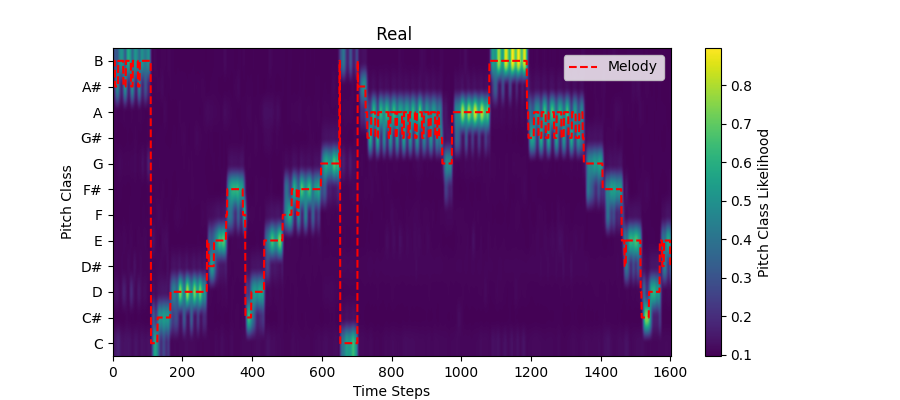
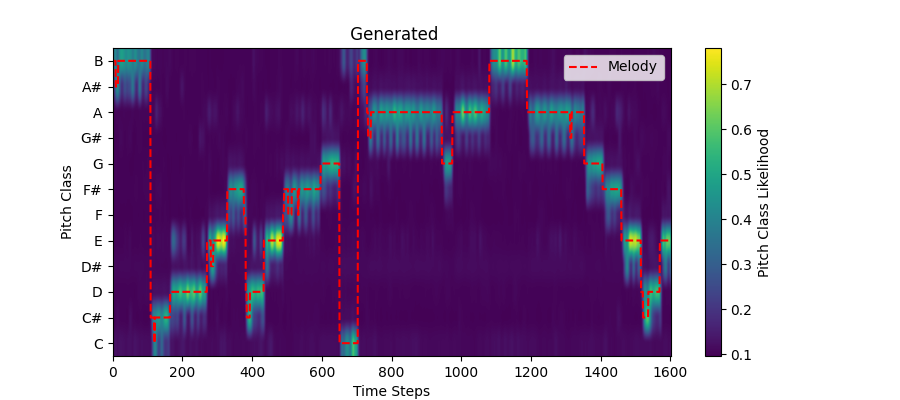
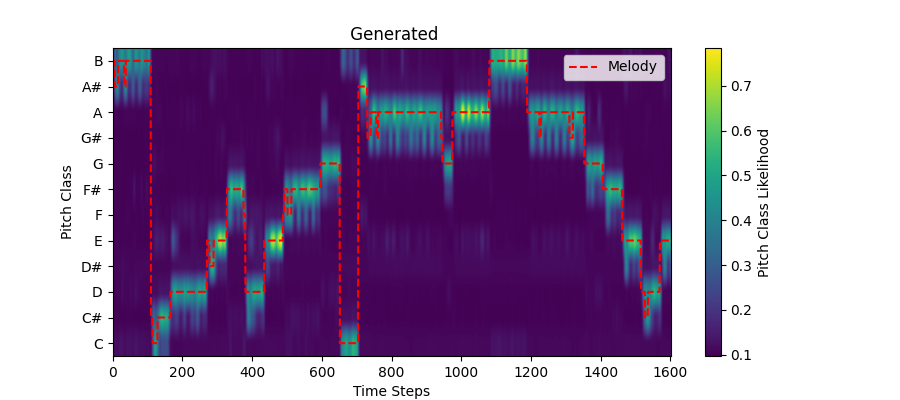
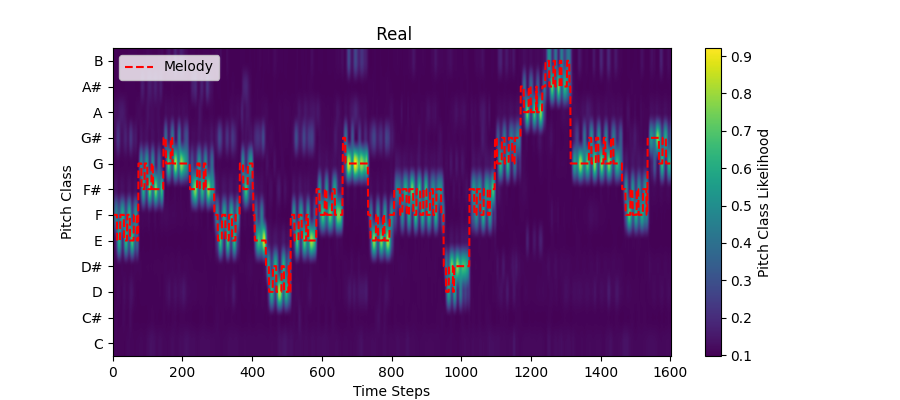
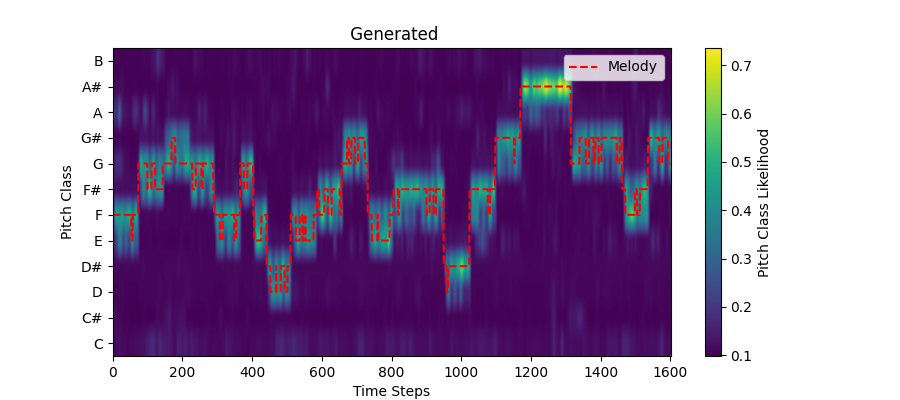
...
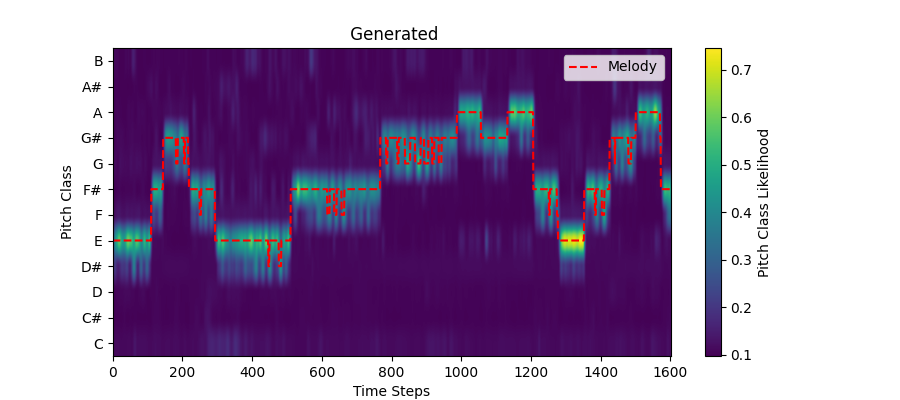
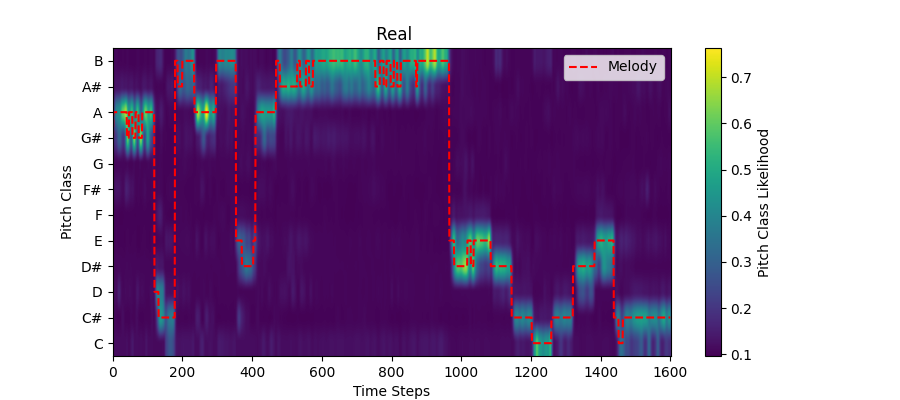
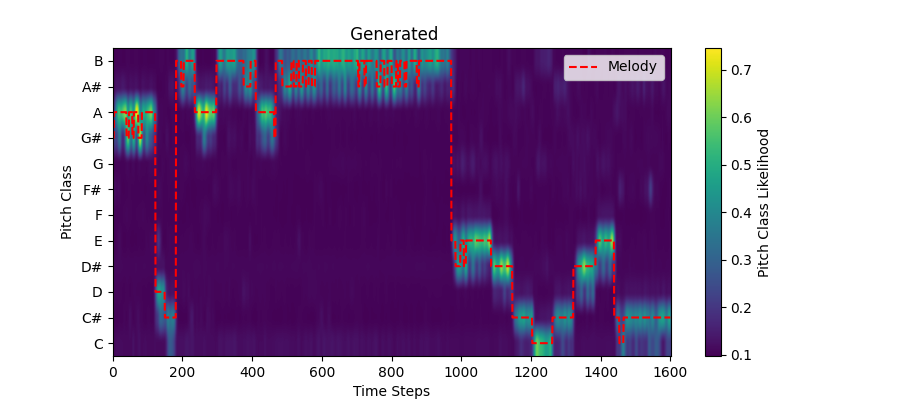
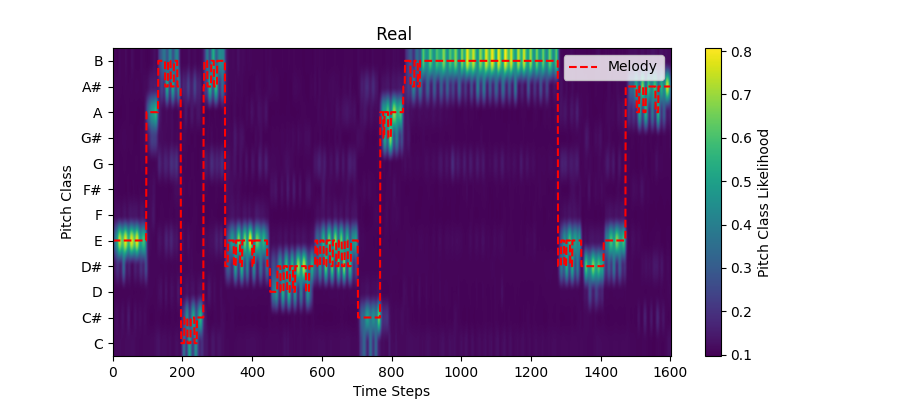
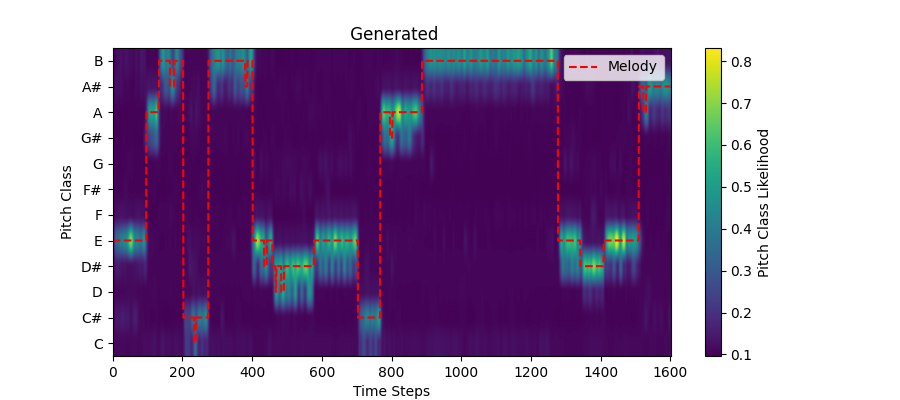

In [4]:
html_table = "<table style='width:100%; table-layout: fixed; border-collapse: collapse;'>"

# Start the header row
html_table += """
    <tr>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Source</th>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Target</th>
    </tr>
"""

# Iterate over the dictionary
for source_object, target_objects in results.items():
    rowspan = len(target_objects)  # Number of targets for this source instrument
    first_row = True  # To handle rowspan for the first target

    for target_object in target_objects:
        # Start the row
        html_table += "<tr>"

        # Add the source instrument in the first column with rowspan if it's the first row
        if first_row:
            html_table += f"""
                <td rowspan="{rowspan}" style="vertical-align: middle; text-align: center; border: 1px solid #ddd; padding: 8px;">
                    <div style="font-weight: bold;">{source_object.instrument_description_html}</div>
                    <div style="margin-top: 5px; height: 19px;"></div> 
                    <div style="margin-top: 10px;">{source_object.audio_html}</div>
                    <div style="margin-top: 10px;">{source_object.pitch_contour_html_img}</div>
                </td>
            """
            first_row = False

        # Add the target instrument in the second column
        dtw_rounded = round(target_object.dtw, 2)
        jaccard_rounded = round(target_object.jaccard, 2)

        html_table += f"""
            <td style="vertical-align: top; text-align: center; border: 1px solid #ddd; padding: 8px;">
                <div style="font-weight: bold;">{target_object.instrument_description_html}</div>
                <div style="margin-top: 5px;">DPD: {dtw_rounded}, JD: {jaccard_rounded}</div>
                <div style="margin-top: 10px;">{target_object.audio_html}</div>
                <div style="margin-top: 10px;">{target_object.pitch_contour_html_img}</div>
            </td>
        """

        # End the row
        html_table += "</tr>"

# End the table
html_table += "</table>"

# Display the HTML table
display(HTML(html_table))

<a id="pitch-shifted-flute"></a>

### Pitch-Shifted



In [5]:
pairs_to_show = [ 
   # ('flute', 'bassoon'),
    ('pitch_flute', 'bassoon'),
    ('25_pitch_flute', 'bassoon'),
]

exp_names = [
    #'flute_to_bassoon_trained_s5_inference_s5',
    'pitch_flute_to_bassoon',
    'pitch_flute_to_bassoon_s5'
]

#indx_to_show = np.zeros(len(pairs_to_show), dtype=int)

indx_to_show = [0,0,0]

sr=24000

results = defaultdict(list)

for exp_name, pair, indx in zip(exp_names, pairs_to_show, indx_to_show):
    source_instrument, target_instrument = pair
    if source_instrument == 'pitch_flute':
        source_instrument_plot = 'flute shifted -20 semitones'
    elif source_instrument == '25_pitch_flute':
        source_instrument_plot = 'flute shifted -25 semitones'
    else:
        source_instrument_plot = source_instrument


    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]

    # Get real audio
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    # Get generated audio
    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()


    tracking_output = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=('Real', 'Generated'))
    dtw, jaccard = tracking_output[0][0]
    img1, img2 = tracking_output[1]

    row_col0 = Instrument(source_instrument_plot, audio_html_real, img1, None, None)
    row_col1 = Instrument(target_instrument, audio_html_generated, img2, dtw, jaccard)
    results[row_col0].append(row_col1)

Source,Target

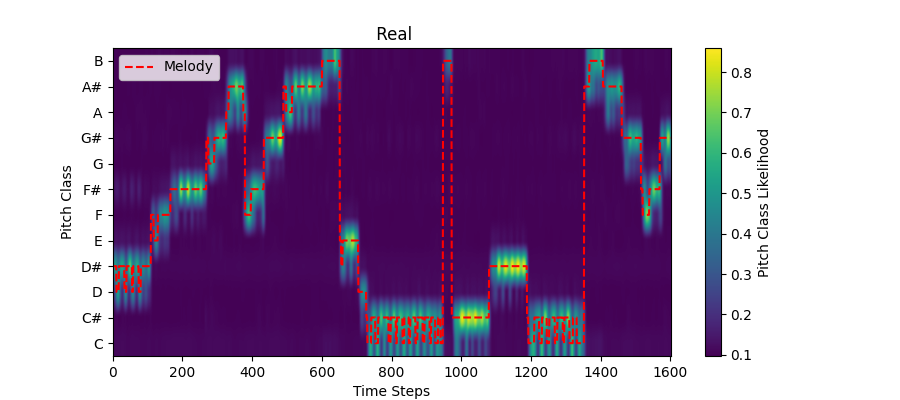
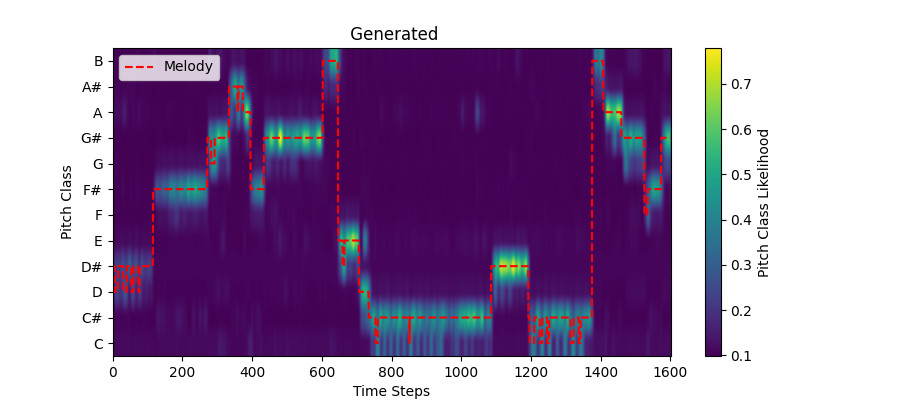
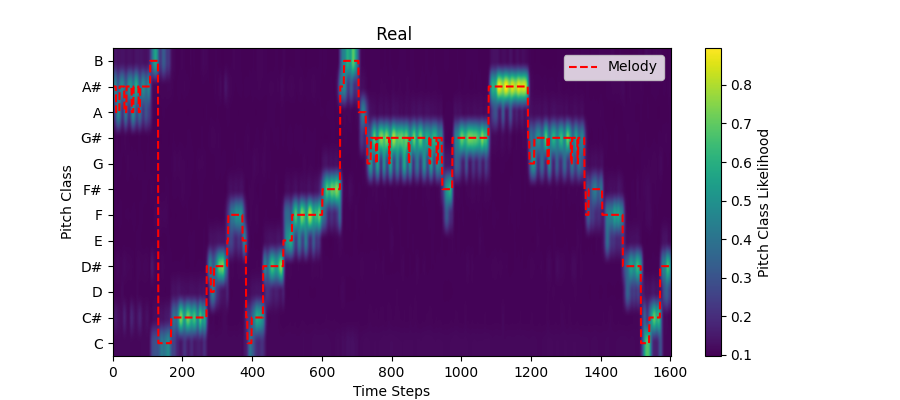
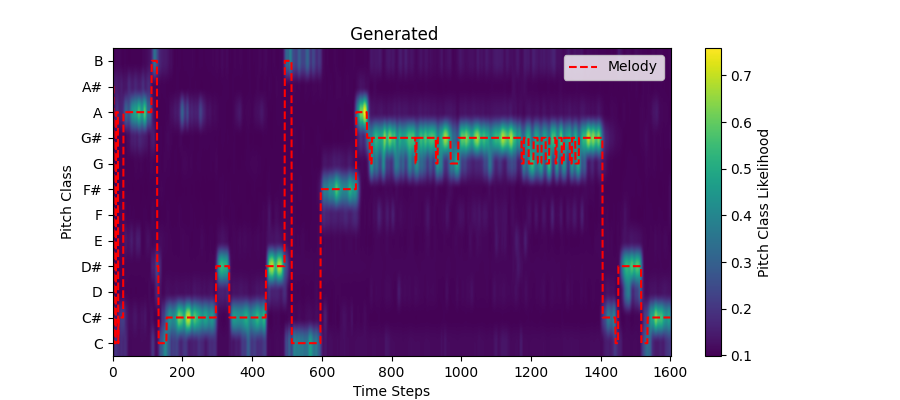

In [6]:
html_table = "<table style='width:100%; table-layout: fixed; border-collapse: collapse;'>"

# Start the header row
html_table += """
    <tr>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Source</th>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Target</th>
    </tr>
"""

# Iterate over the dictionary
for source_object, target_objects in results.items():
    rowspan = len(target_objects)  # Number of targets for this source instrument
    first_row = True  # To handle rowspan for the first target

    for target_object in target_objects:
        # Start the row
        html_table += "<tr>"

        # Add the source instrument in the first column with rowspan if it's the first row
        if first_row:
            html_table += f"""
                <td rowspan="{rowspan}" style="vertical-align: middle; text-align: center; border: 1px solid #ddd; padding: 8px;">
                    <div style="font-weight: bold;">{source_object.instrument_description_html}</div>
                    <div style="margin-top: 5px; height: 19px;"></div> 
                    <div style="margin-top: 10px;">{source_object.audio_html}</div>
                    <div style="margin-top: 10px;">{source_object.pitch_contour_html_img}</div>
                </td>
            """
            first_row = False

        # Add the target instrument in the second column
        dtw_rounded = round(target_object.dtw, 2)
        jaccard_rounded = round(target_object.jaccard, 2)

        html_table += f"""
            <td style="vertical-align: top; text-align: center; border: 1px solid #ddd; padding: 8px;">
                <div style="font-weight: bold;">{target_object.instrument_description_html}</div>
                <div style="margin-top: 5px;">DPD: {dtw_rounded}, JD: {jaccard_rounded}</div>
                <div style="margin-top: 10px;">{target_object.audio_html}</div>
                <div style="margin-top: 10px;">{target_object.pitch_contour_html_img}</div>
            </td>
        """

        # End the row
        html_table += "</tr>"

# End the table
html_table += "</table>"

display(HTML(html_table))

<a id="chunk-based-minibatch"></a>

### Chunk-Based Minibatch



In [7]:
pairs_to_show = [ 
    ('flute', 'violin'),
    ('flute', 'violin'),
    ('violin', 'flute'),
    ('violin', 'flute')
]

exp_names = [
    'flute_to_violin_s100_time_chunk',
    'flute_to_violin_s100_time_channel_chunk',
    'violin_to_flute_s100_time_chunk',
    'violin_to_flute_s100_time_channel_chunk',
]

#indx_to_show = np.zeros(len(pairs_to_show), dtype=int)

indx_to_show = [0,0,0,0]

sr=24000

results = defaultdict(list)

for exp_name, pair, indx in zip(exp_names, pairs_to_show, indx_to_show):
    source_instrument, target_instrument = pair
    if exp_name == 'flute_to_violin_s100_time_chunk':
        descr = 'model trained with time chunk size 4 and channel chunk size 0'
    elif exp_name == 'flute_to_violin_s100_time_channel_chunk':
        descr = 'model trained with time chunk size 4 and channel chunk size 32'
    elif exp_name == 'violin_to_flute_s100_time_chunk':
        descr = 'model trained with time chunk size 4 and channel chunk size 0'
    elif exp_name == 'violin_to_flute_s100_time_channel_chunk':
        descr = 'model trained with time chunk size 4 and channel chunk size 32'
    else:
        descr = f'{source_instrument} -> {target_instrument}'


    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]

    # Get real audio
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    # Get generated audio
    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()


    tracking_output = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=('Real', 'Generated'))
    dtw, jaccard = tracking_output[0][0]
    img1, img2 = tracking_output[1]

    row_col0 = Instrument(source_instrument, audio_html_real, img1, None, None, model_descr=descr)
    row_col1 = Instrument(target_instrument, audio_html_generated, img2, dtw, jaccard)
    results[row_col0].append(row_col1)

Source,Target

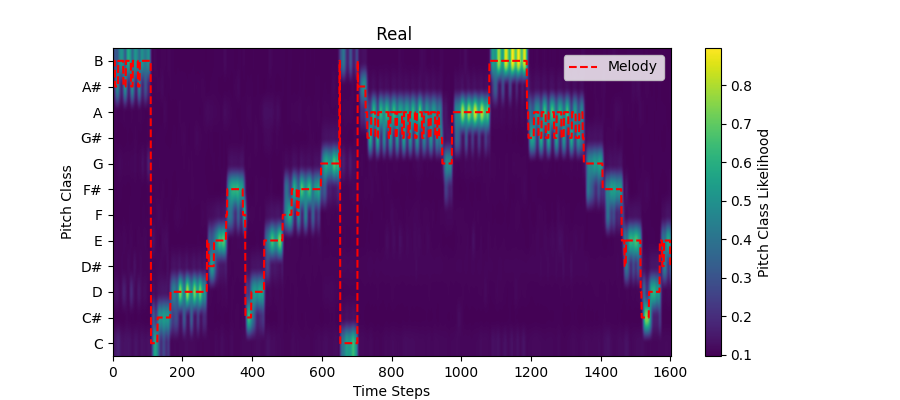
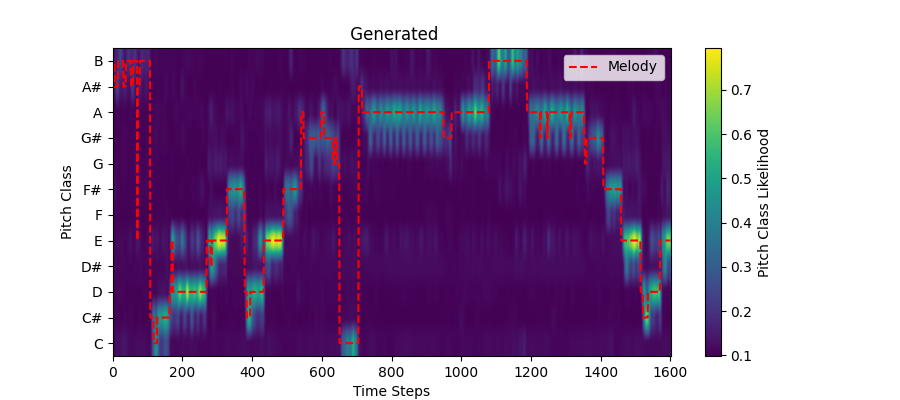
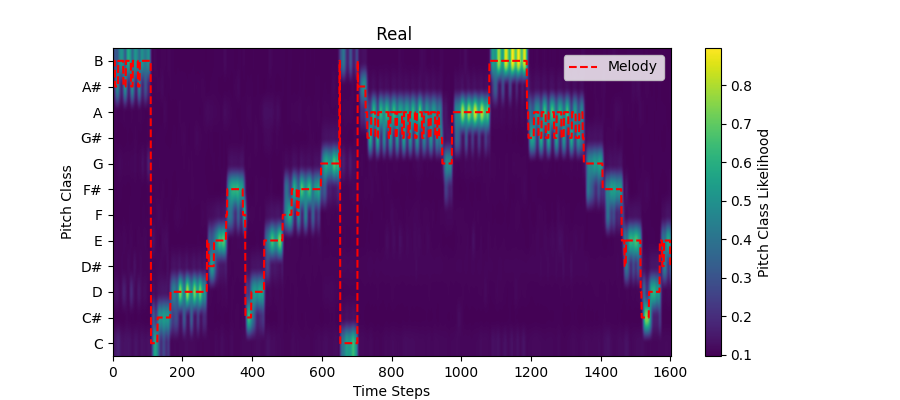
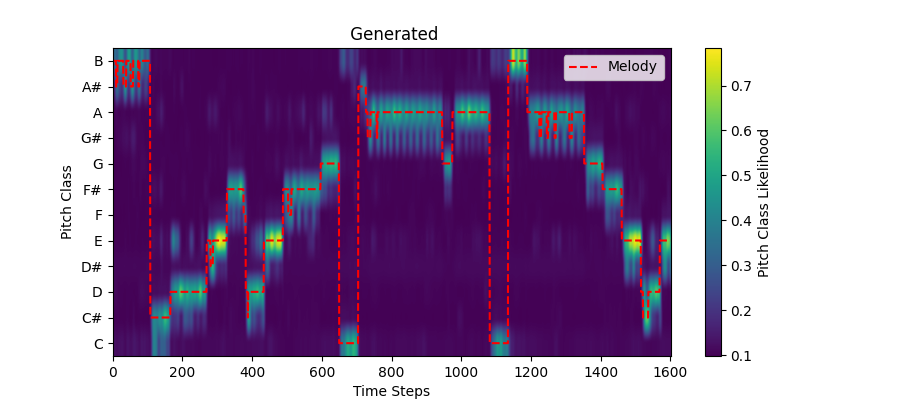
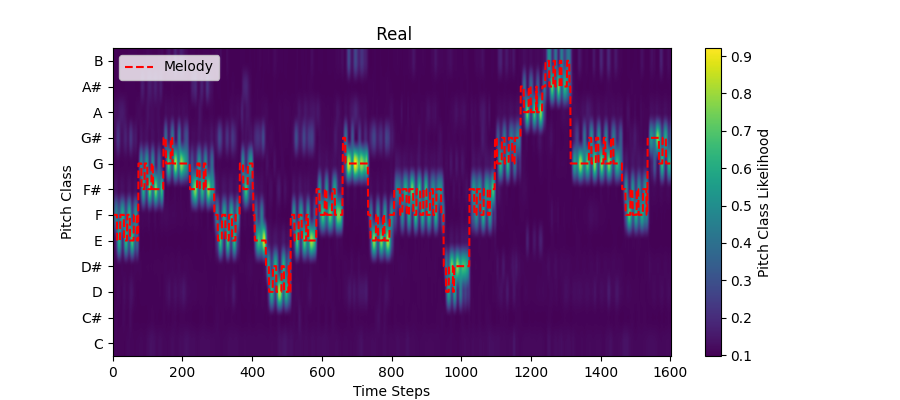
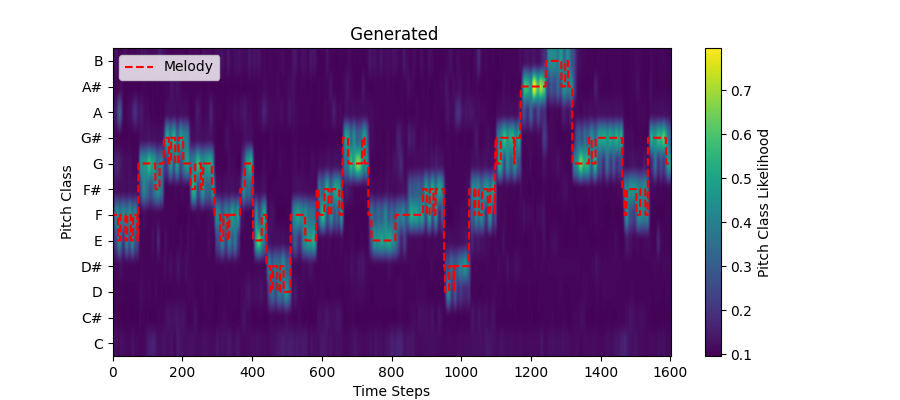
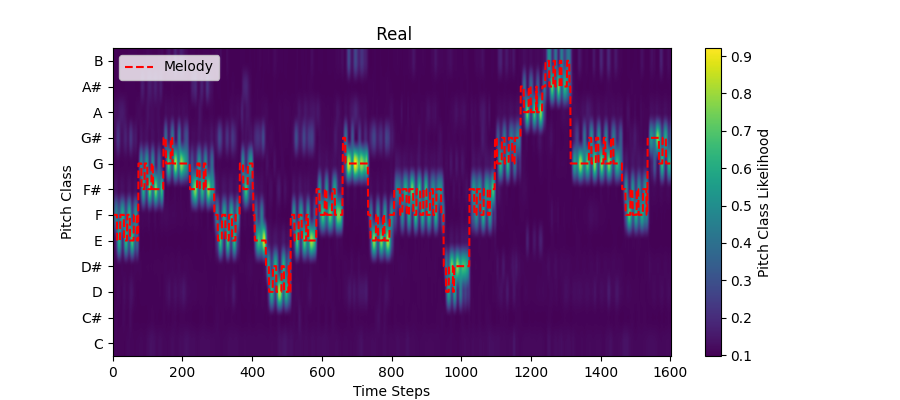
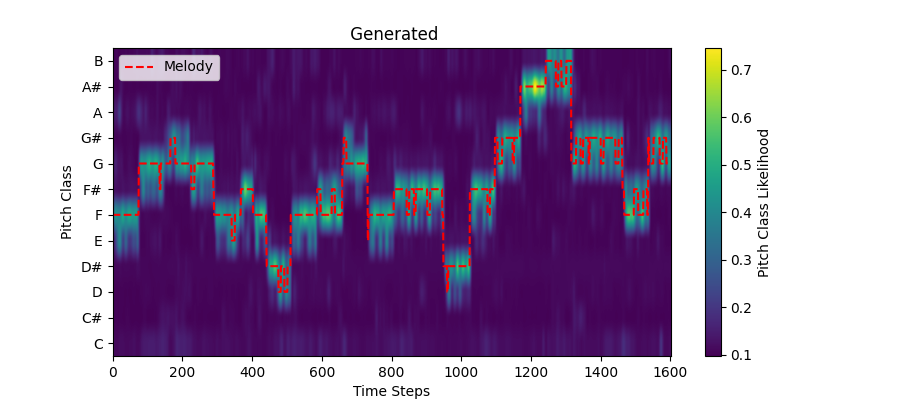

In [8]:
html_table = "<table style='width:100%; table-layout: fixed; border-collapse: collapse;'>"

# Start the header row
html_table += """
    <tr>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Source</th>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Target</th>
    </tr>
"""

# Iterate over the dictionary
for source_object, target_objects in results.items():
    rowspan = len(target_objects)  # Number of targets for this source instrument
    first_row = True  # To handle rowspan for the first target

    for target_object in target_objects:
        # Start the row
        html_table += "<tr>"

        # Add the source instrument in the first column with rowspan if it's the first row
        if first_row:
            html_table += f"""
                <td rowspan="{rowspan}" style="vertical-align: middle; text-align: center; border: 1px solid #ddd; padding: 8px;">
                    <div style="font-weight: bold;">{source_object.instrument_description_html}</div>
                    <div style="margin-top: 5px;">{source_object.model_descr}</div>
                    <div style="margin-top: 10px;">{source_object.audio_html}</div>
                    <div style="margin-top: 10px;">{source_object.pitch_contour_html_img}</div>
                </td>
            """
            first_row = False

        # Add the target instrument in the second column
        dtw_rounded = round(target_object.dtw, 2)
        jaccard_rounded = round(target_object.jaccard, 2)

        html_table += f"""
            <td style="vertical-align: top; text-align: center; border: 1px solid #ddd; padding: 8px;">
                <div style="font-weight: bold;">{target_object.instrument_description_html}</div>
                <div style="margin-top: 5px;">DPD: {dtw_rounded}, JD: {jaccard_rounded}</div>
                <div style="margin-top: 10px;">{target_object.audio_html}</div>
                <div style="margin-top: 10px;">{target_object.pitch_contour_html_img}</div>
            </td>
        """

        # End the row
        html_table += "</tr>"

# End the table
html_table += "</table>"

display(HTML(html_table))

<a id="impact-of-different-sigma-max-and-sigma-n"></a>

## Impact of Different Sigma Max and Sigma N



Source,Noise,Target

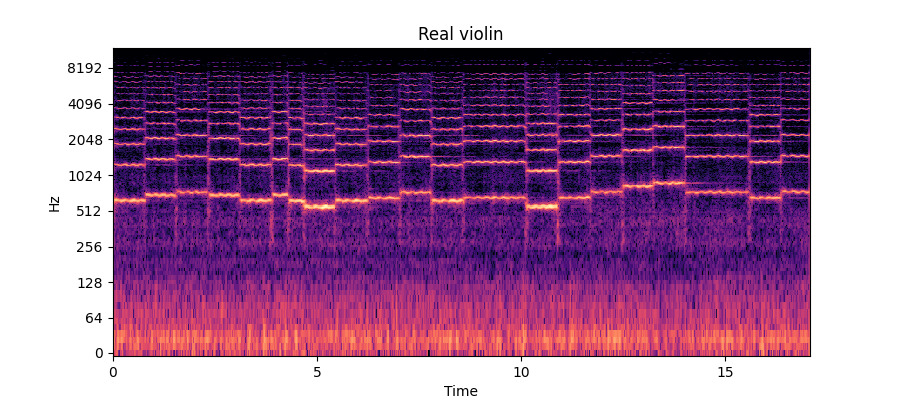
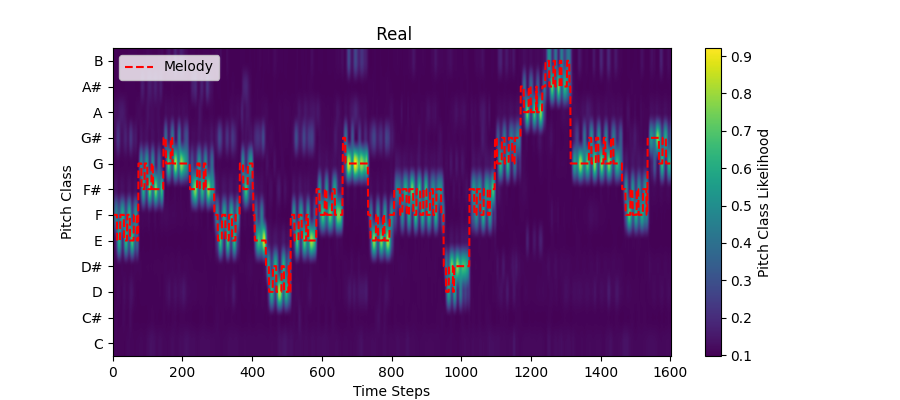
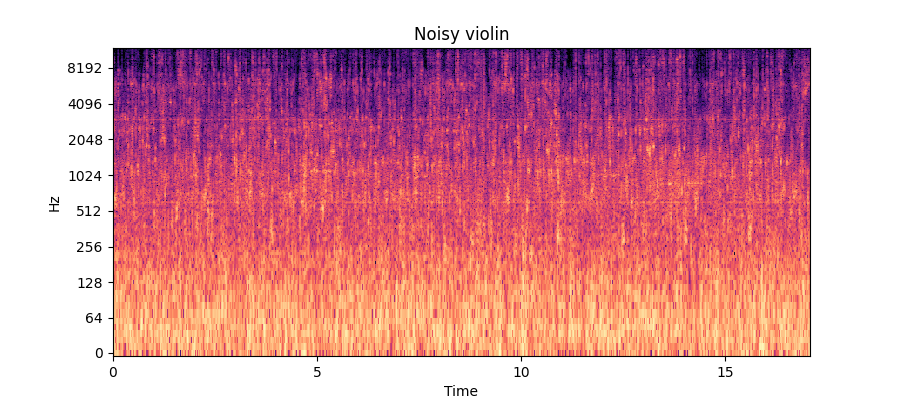
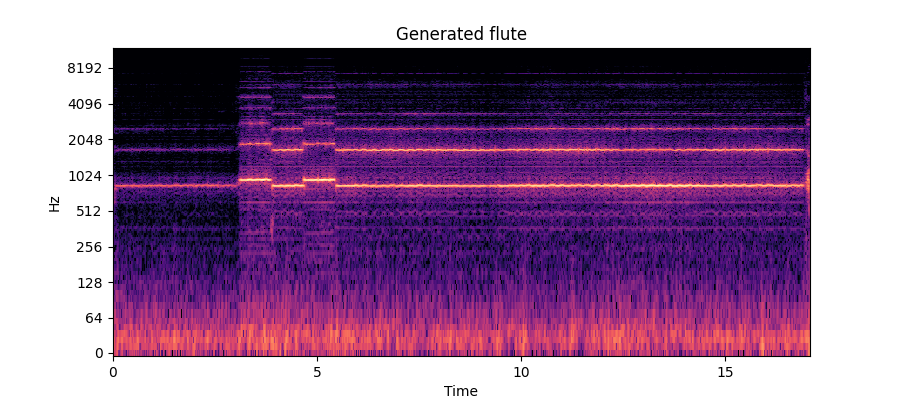
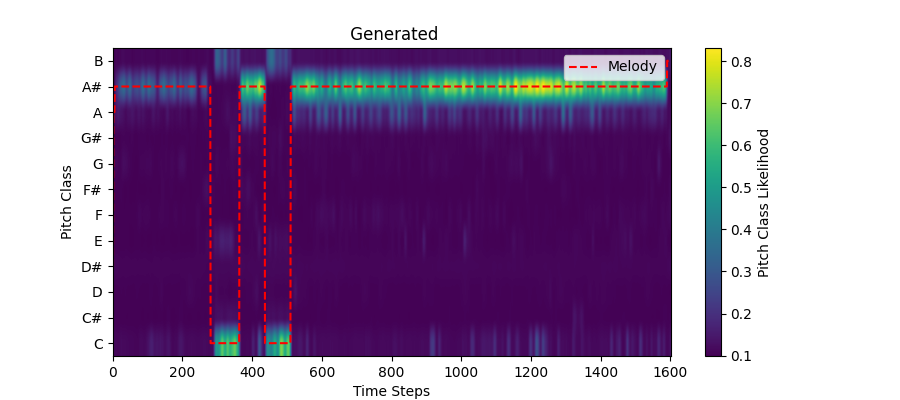

Source,Noise,Target

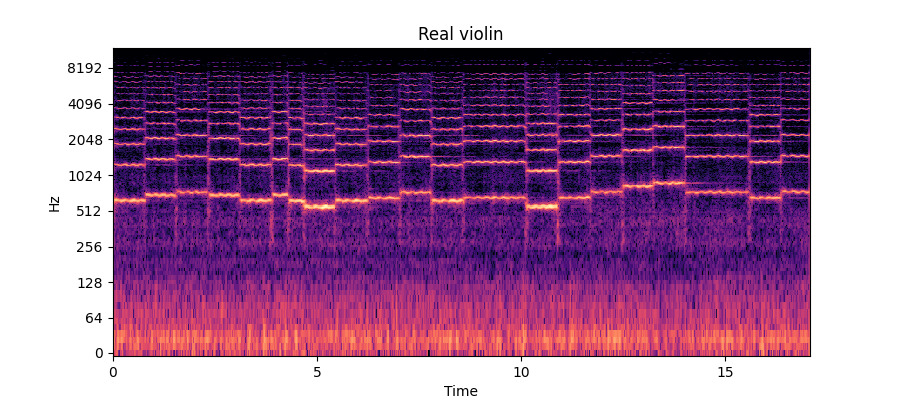
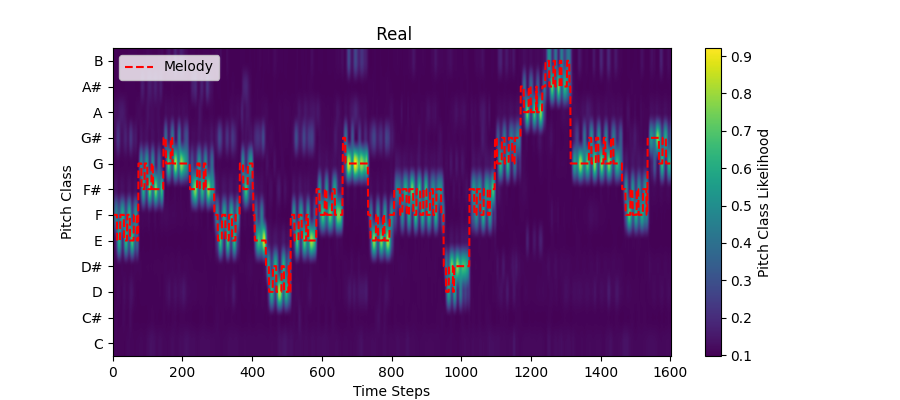
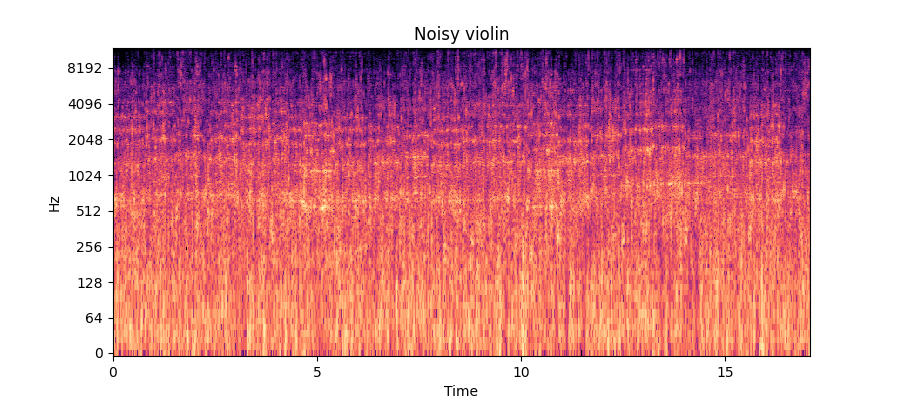
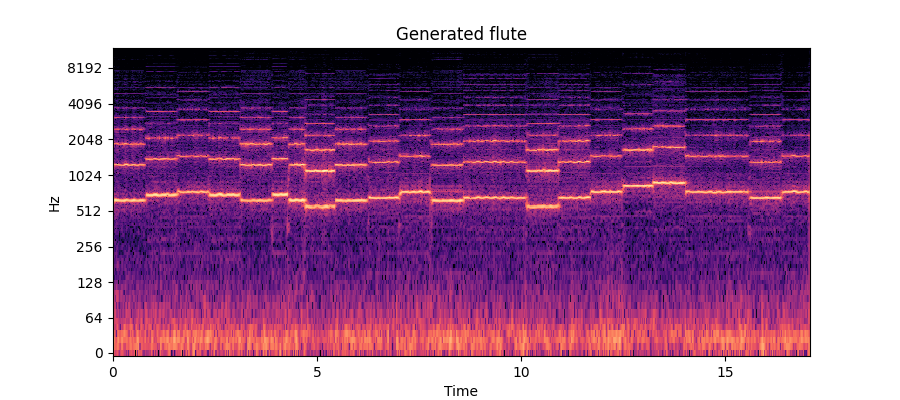
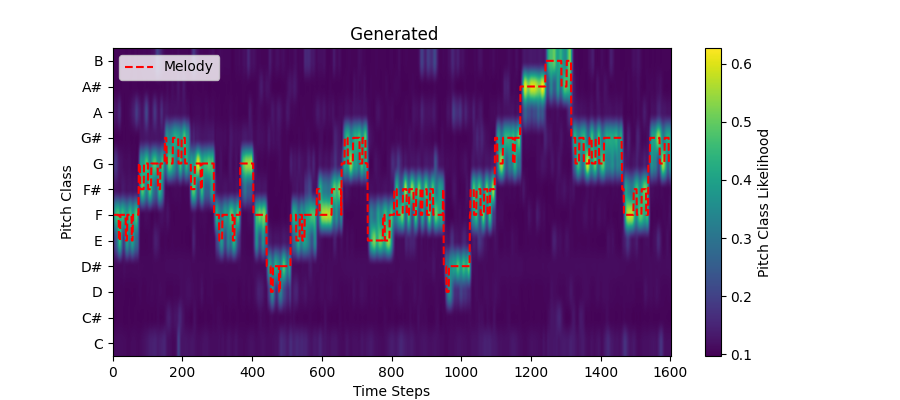

In [9]:
pairs_to_show = [ 
    ('violin', 'flute'),
    ('violin', 'flute')
]

exp_names = [
    'violin_to_flute_s100_old_shared_space',
    'violin_to_flute_s100_old',
]

noises_names = [
    'violin_to_flute_noises_s100',
    'violin_to_flute_noises_s5'
]

model_descr = ['model with sigma_max=100 and sigma_N=100', 'model with sigma_max=100 and sigma_N=5']

indx_to_show = [0, 0]

sr = 24000

for exp_name, pair, indx, noise_name, model_descr in zip(exp_names, pairs_to_show, indx_to_show, noises_names,model_descr):
    source_instrument, target_instrument = pair

    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)
    source_generated_noise_path = os.path.join(output_path, noise_name, 'audios', f'{indx}.wav')
    source_generated_noise = load_resample_prepare_audio(source_generated_noise_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    noise_html = Audio(undo_prepare_audio(source_generated_noise), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()

    # Create spectrograms for real, noise, and generated audio separately
    fig, axs = plt.subplots(1, 1, figsize=(9, 4))
    D_real = librosa.amplitude_to_db(np.abs(librosa.stft(undo_prepare_audio(source_real_audio)[0])), ref=np.max)
    librosa.display.specshow(D_real, sr=sr, x_axis='time', y_axis='log', ax=axs)
    axs.set_title(f"Real {source_instrument}")
    buf1 = io.BytesIO()
    plt.savefig(buf1, format='png')
    buf1.seek(0)
    spectrogram_real_html = base64.b64encode(buf1.read()).decode('utf-8')
    buf1.close()
    plt.close(fig)

    fig, axs = plt.subplots(1, 1, figsize=(9, 4))
    D_noise = librosa.amplitude_to_db(np.abs(librosa.stft(undo_prepare_audio(source_generated_noise)[0])), ref=np.max)
    librosa.display.specshow(D_noise, sr=sr, x_axis='time', y_axis='log', ax=axs)
    axs.set_title(f"Noisy {source_instrument}")
    buf2 = io.BytesIO()
    plt.savefig(buf2, format='png')
    buf2.seek(0)
    spectrogram_noise_html = base64.b64encode(buf2.read()).decode('utf-8')
    buf2.close()
    plt.close(fig)

    fig, axs = plt.subplots(1, 1, figsize=(9, 4))
    D_generated = librosa.amplitude_to_db(np.abs(librosa.stft(undo_prepare_audio(source_generated_audio)[0])), ref=np.max)
    librosa.display.specshow(D_generated, sr=sr, x_axis='time', y_axis='log', ax=axs)
    axs.set_title(f"Generated {target_instrument}")
    buf3 = io.BytesIO()
    plt.savefig(buf3, format='png')
    buf3.seek(0)
    spectrogram_generated_html = base64.b64encode(buf3.read()).decode('utf-8')
    buf3.close()
    plt.close(fig)

    tracking_output = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=('Real', 'Generated'))
    dtw, jaccard = tracking_output[0][0]
    img1, img2 = tracking_output[1]

    html_table = f"""
    <table style="width:100%; table-layout: fixed; border-collapse: collapse;">
        <tr>
            <th style="text-align: center; border: 1px solid #ddd; padding: 8px;">Source</th>
            <th style="text-align: center; border: 1px solid #ddd; padding: 8px;">Noise</th>
            <th style="text-align: center; border: 1px solid #ddd; padding: 8px;">Target</th>
        </tr>
        <tr>
            <td style="vertical-align: top; text-align: center; border: 1px solid #ddd; padding: 8px;">
                <div style="font-weight: bold;">{source_instrument}</div>
                <div style="margin-top: 5px;">{model_descr}</div>
                <div style="margin-top: 10px;">{audio_html_real}</div>
                <div style="margin-top: 10px;"><img src="data:image/png;base64,{spectrogram_real_html}" /></div>
                <div style="margin-top: 10px;">{img1}</div>
            </td>
            <td style="vertical-align: top; text-align: center; border: 1px solid #ddd; padding: 8px;">
                <div style="font-weight: bold;">Noisy {source_instrument}</div>
                <div style="margin-top: 5px; height: 19px;"></div> 
                <div style="margin-top: 10px;">{noise_html}</div>
                <div style="margin-top: 10px;"><img src="data:image/png;base64,{spectrogram_noise_html}" /></div>
            </td>
            <td style="vertical-align: top; text-align: center; border: 1px solid #ddd; padding: 8px;">
                <div style="font-weight: bold;">{target_instrument}</div>
                <div style="margin-top: 5px;">DPD: {round(dtw, 2)}, JD: {round(jaccard, 2)}</div>
                <div style="margin-top: 10px;">{audio_html_generated}</div>
                <div style="margin-top: 10px;"><img src="data:image/png;base64,{spectrogram_generated_html}" /></div>
                <div style="margin-top: 10px;">{img2}</div>
            </td>
        </tr>
    </table>
    """

    display(HTML(html_table))

<a id="shared-space"></a>

## Shared Space



The following audio samples were generated using flute and violin models, both with sigma_max=100 and sigma_N=100, by sampling directly from N(0, sigma_max). Below, we provide examples of audio pairs that were considered melodically similar and those that were not.


In [10]:
indx = 0
exp_name = 'flute_to_violin'

source_instrument, target_instrument = ('flute', 'violin')

# 0 diff melodies, 1 similiar melodies
indx_list = [6,19]
model_descr_list = ['Similar Melodies (DPD < 0.7)', 'Different Melodies (DPD >= 0.7)']

results = defaultdict(list)

for indx, model_descr in zip(indx_list, model_descr_list):

    # Get generated Flute
    flute_generated_audio_path = os.path.join(output_path, exp_name, 'audios', 'flute')
    flute_name = os.listdir(flute_generated_audio_path)[indx]
    flute_generated_audio = load_resample_prepare_audio(os.path.join(flute_generated_audio_path, flute_name), sr)

    violin_generated_audio_path = os.path.join(output_path, exp_name, 'audios', 'violin')
    violin_generated_audio = load_resample_prepare_audio(os.path.join(violin_generated_audio_path, flute_name), sr)

    flute_html = Audio(undo_prepare_audio(flute_generated_audio), rate=sr)._repr_html_()
    violin_html = Audio(undo_prepare_audio(violin_generated_audio), rate=sr)._repr_html_()

    tracking_output = pitch_tracker.cals_pitch_metric(flute_generated_audio, violin_generated_audio, 'both', plot=True, pair=('', ''))
    dtw, jaccard = tracking_output[0][0]
    img1, img2 = tracking_output[1]

    #print(f'DTW: {dtw}, Jaccard: {jaccard}')

    row_col0 = Instrument('flute', flute_html, img1, None, None, model_descr=model_descr)
    row_col1 = Instrument('violin', violin_html, img2, dtw, jaccard)
    results[row_col0].append(row_col1)

Flute,Violin

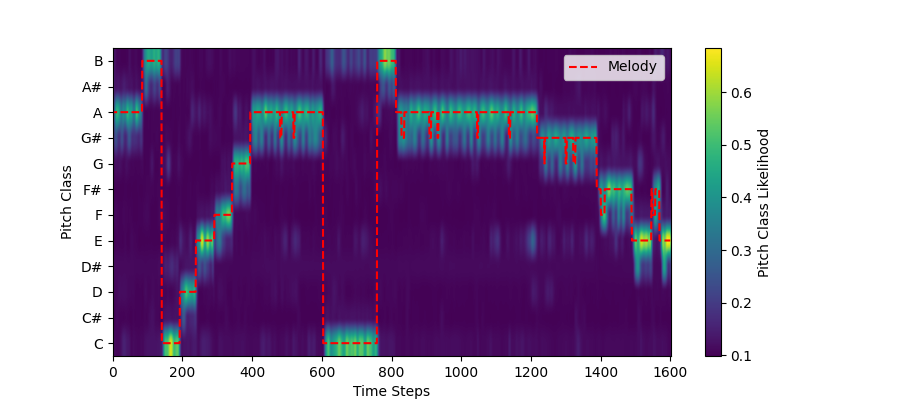
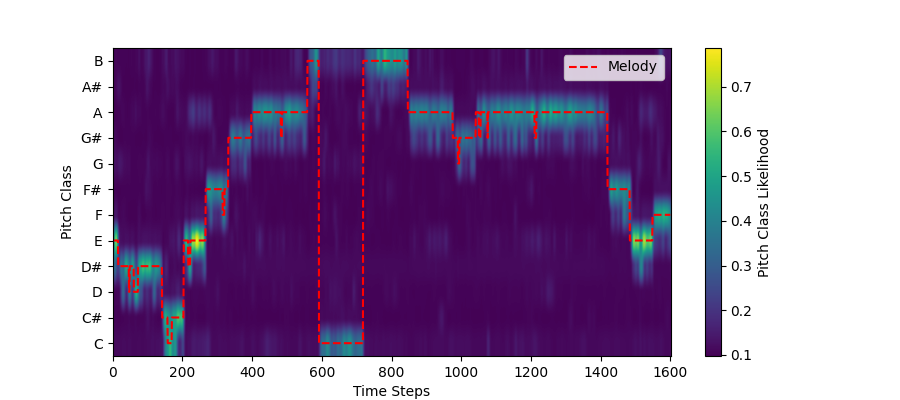
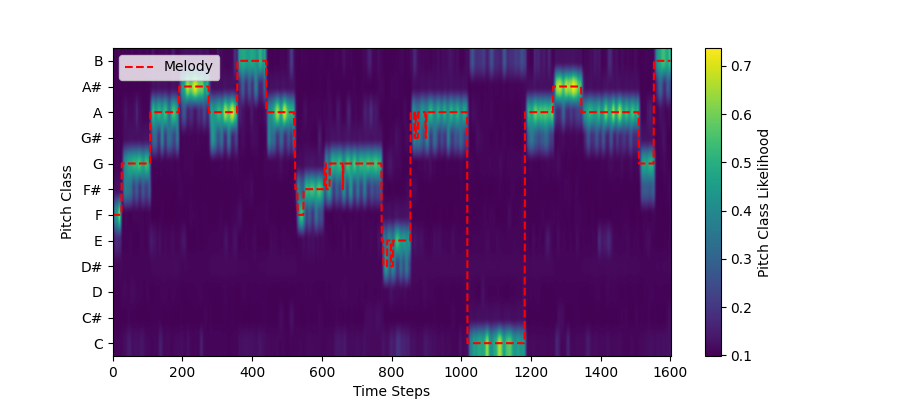
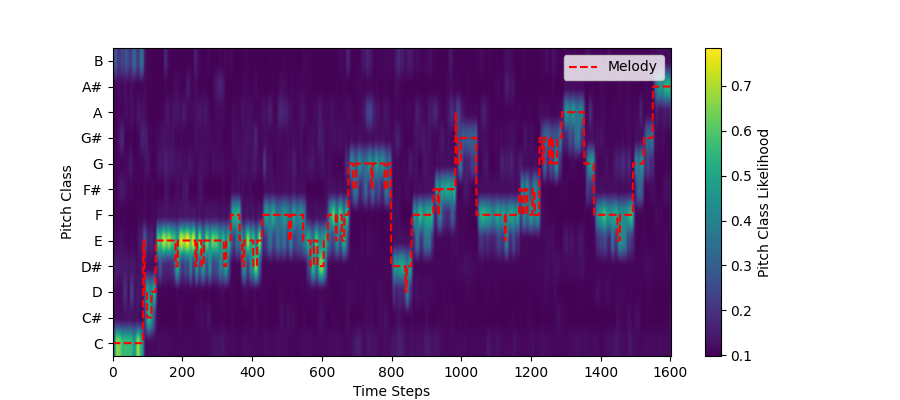

In [11]:
html_table = "<table style='width:100%; table-layout: fixed; border-collapse: collapse;'>"

# Start the header row
html_table += """
    <tr>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Flute</th>
        <th style="text-align: center; width: 40%; border: 1px solid #ddd; padding: 8px;">Violin</th>
    </tr>
"""

# Iterate over the dictionary
for source_object, target_objects in results.items():
    rowspan = len(target_objects)  # Number of targets for this source instrument
    first_row = True  # To handle rowspan for the first target

    for target_object in target_objects:
        # Start the row
        html_table += "<tr>"

        # Add the source instrument in the first column with rowspan if it's the first row
        if first_row:
            html_table += f"""
                <td rowspan="{rowspan}" style="vertical-align: middle; text-align: center; border: 1px solid #ddd; padding: 8px;">
                    <div style="margin-top: 5px;">{source_object.model_descr}</div>
                    <div style="margin-top: 10px;">{source_object.audio_html}</div>
                    <div style="margin-top: 10px;">{source_object.pitch_contour_html_img}</div>
                </td>
            """
            first_row = False

        # Add the target instrument in the second column
        dtw_rounded = round(target_object.dtw, 2)
        jaccard_rounded = round(target_object.jaccard, 2)

        html_table += f"""
            <td style="vertical-align: top; text-align: center; border: 1px solid #ddd; padding: 8px;">
                <div style="margin-top: 5px;">DPD: {dtw_rounded}, JD: {jaccard_rounded}</div>
                <div style="margin-top: 10px;">{target_object.audio_html}</div>
                <div style="margin-top: 10px;">{target_object.pitch_contour_html_img}</div>
            </td>
        """

        # End the row
        html_table += "</tr>"

# End the table
html_table += "</table>"

# Display the HTML table
display(HTML(html_table))

<a id="cycle-consistency"></a>

## Cycle Consistency



The following results were obtained by calculating the normalized L2 norm between the input Encodec embeddings derived from flute audio and the generated Encodec embeddings after converting the flute to violin and back to flute.

In [14]:
path_json = os.path.join(output_path, 'l2_vs_num_steps.json')
with open(path_json, 'r') as f:
    data = json.load(f)


,

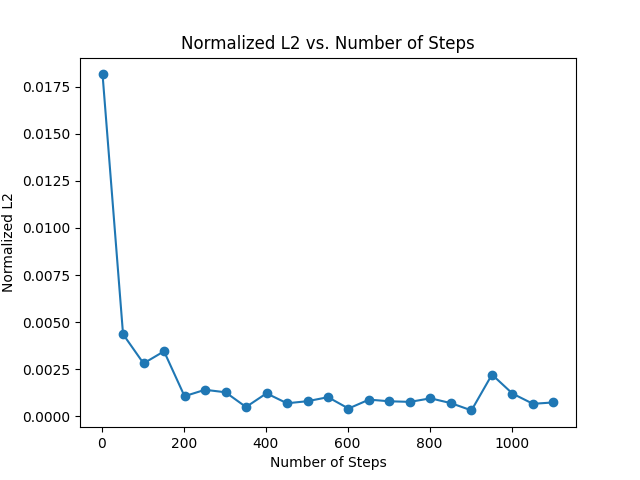
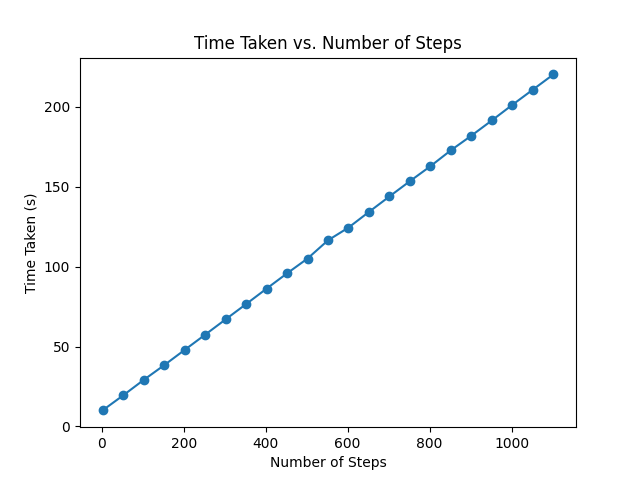

In [18]:

# Function to create the plot and return it as an HTML image
def create_plot(x, y, xlabel, ylabel, title):
    fig, ax = plt.subplots()
    ax.plot(x, y, marker='o')
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    
    # Save the plot to a BytesIO object
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    buf.seek(0)
    img_base64 = base64.b64encode(buf.read()).decode('utf-8')
    buf.close()
    plt.close(fig)
    
    return f'<img src="data:image/png;base64,{img_base64}" />'

# Extract data
num_steps = data['num_steps'][:23]
l2_emb = data['l2_emb']
time_taken = data['time_taken']

# Create the plots
plot1_html = create_plot(num_steps, l2_emb, 'Number of Steps', 'Normalized L2', 'Normalized L2 vs. Number of Steps')
plot2_html = create_plot(num_steps, time_taken, 'Number of Steps', 'Time Taken (s)', 'Time Taken vs. Number of Steps')

# Combine the plots into a grid layout
html_grid = f"""
<table style="width:100%; table-layout: fixed;">
    <tr>
        <td style="text-align: center; vertical-align: top;">
            {plot1_html}
        </td>
        <td style="text-align: center; vertical-align: top;">
            {plot2_html}
        </td>
    </tr>
</table>
"""

# Display the HTML grid
display(HTML(html_grid))